In [1]:
# import -- > libraries
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
pd.set_option('display.max_columns', None)
import re
import missingno

# Sklearn --> Preprocessing 

from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import RobustScaler , OrdinalEncoder , OneHotEncoder ,LabelEncoder
from sklearn.pipeline import Pipeline , FeatureUnion
from sklearn_features.transformers import DataFrameSelector

# Sklearn --> Models
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB





# Slearn --> metrics
from sklearn.metrics import accuracy_score

# Slearn --> Tuning
from sklearn.model_selection import GridSearchCV


In [2]:
# Read data 
df_train = pd.read_csv('train_Air.csv')
df_train.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied


In [3]:
df_train.shape

(103904, 25)

In [4]:
# Drop columns
df_train.drop(columns = ['Unnamed: 0' , 'id'] , axis = 1 , inplace = True)

In [5]:
# check df
df_train.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied


In [6]:
#Check Shape
df_train.shape

(103904, 23)

In [7]:
#check info about data 
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             103904 non-null  object 
 1   Customer Type                      103904 non-null  object 
 2   Age                                103904 non-null  int64  
 3   Type of Travel                     103904 non-null  object 
 4   Class                              103904 non-null  object 
 5   Flight Distance                    103904 non-null  int64  
 6   Inflight wifi service              103904 non-null  int64  
 7   Departure/Arrival time convenient  103904 non-null  int64  
 8   Ease of Online booking             103904 non-null  int64  
 9   Gate location                      103904 non-null  int64  
 10  Food and drink                     103904 non-null  int64  
 11  Online boarding                    1039

In [8]:
# check NAN values 
df_train.isna().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             310
satisfaction                           0
dtype: int64

In [9]:
# Drop NAN values
df_train.dropna(axis = 0 , inplace = True)

In [10]:
# Describe to categorical features
df_train.select_dtypes(include = 'object').describe().T

,count,unique,top,freq
Gender,103594,2,Female,52576
Customer Type,103594,2,Loyal Customer,84662
Type of Travel,103594,2,Business travel,71465
Class,103594,3,Business,49533
satisfaction,103594,2,neutral or dissatisfied,58697


In [11]:
# Describe to numerical features
df_train.select_dtypes(include = 'number').describe().T

,count,mean,std,min,25%,50%,75%,max
Age,103594.0,39.380466,15.113125,7.0,27.0,40.0,51.0,85.0
Flight Distance,103594.0,1189.325202,997.297235,31.0,414.0,842.0,1743.0,4983.0
Inflight wifi service,103594.0,2.729753,1.327866,0.0,2.0,3.0,4.0,5.0
Departure/Arrival time convenient,103594.0,3.060081,1.525233,0.0,2.0,3.0,4.0,5.0
Ease of Online booking,103594.0,2.756984,1.398934,0.0,2.0,3.0,4.0,5.0
Gate location,103594.0,2.977026,1.277723,0.0,2.0,3.0,4.0,5.0
Food and drink,103594.0,3.202126,1.329401,0.0,2.0,3.0,4.0,5.0
Online boarding,103594.0,3.250497,1.349433,0.0,2.0,3.0,4.0,5.0
Seat comfort,103594.0,3.439765,1.318896,0.0,2.0,4.0,5.0,5.0
Inflight entertainment,103594.0,3.358341,1.333030,0.0,2.0,4.0,4.0,5.0


In [12]:
# Check nunique for each col
df_train.nunique()

Gender                                  2
Customer Type                           2
Age                                    75
Type of Travel                          2
Class                                   3
Flight Distance                      3802
Inflight wifi service                   6
Departure/Arrival time convenient       6
Ease of Online booking                  6
Gate location                           6
Food and drink                          6
Online boarding                         6
Seat comfort                            6
Inflight entertainment                  6
On-board service                        6
Leg room service                        6
Baggage handling                        5
Checkin service                         6
Inflight service                        6
Cleanliness                             6
Departure Delay in Minutes            445
Arrival Delay in Minutes              455
satisfaction                            2
dtype: int64

# EDA

In [13]:
 df_train.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied


In [14]:
# convert those columns from numeric to categorical because those columns presentes value not numbers 

df_train.iloc[:, 6:20] = df_train.iloc[:, 6:20].astype('object')

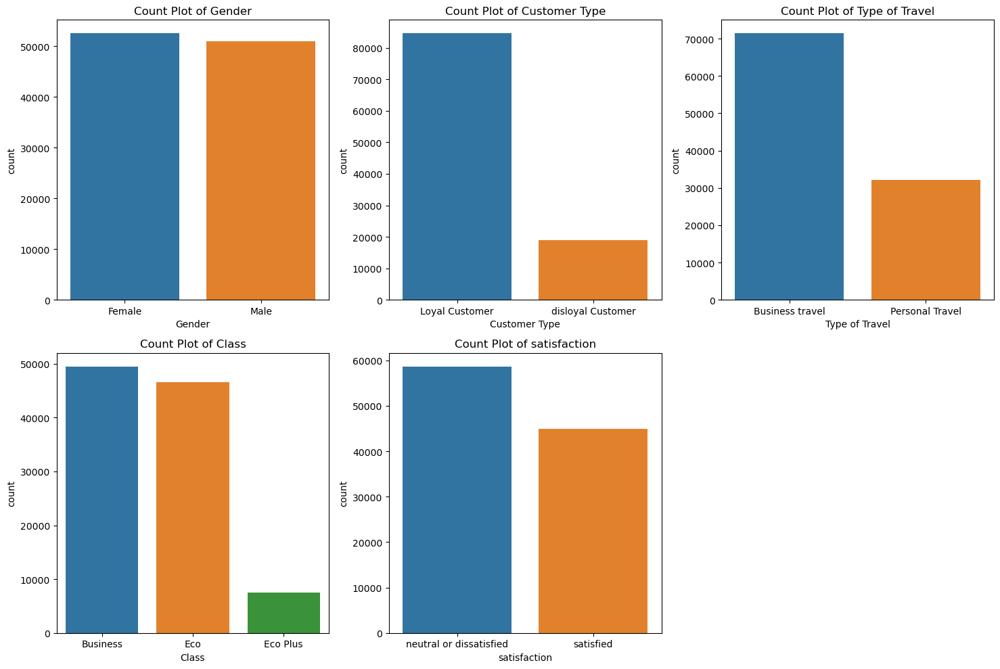

In [15]:
cat_var = ['Gender' , 'Customer Type' , 'Type of Travel' , 'Class' , 'satisfaction']

fig , axs = plt.subplots(nrows=2 , ncols=3 , figsize = (15 , 10))
axs = axs.flatten()
for i , var in enumerate(cat_var):
    sns.countplot(data=df_train , x = var , ax = axs[i] , order= df_train[var].value_counts().index)
    axs[i].set_xticklabels(axs[i].get_xticklabels() )
    axs[i].set_title(f"Count Plot of {var}")
    
fig.tight_layout()

fig.delaxes(axs[5])

plt.show()

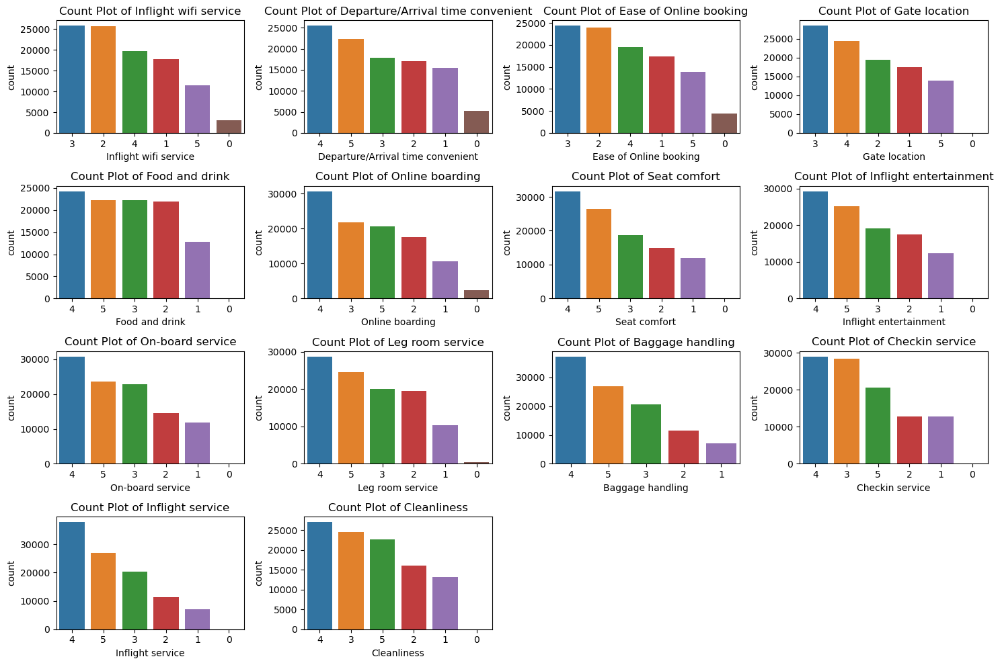

In [16]:
rat_var = df_train.iloc[:, 6:20]
fig , axs = plt.subplots(nrows=4 , ncols=4 , figsize = (15 , 10))
axs = axs.flatten()
for i , var in enumerate(rat_var):
    sns.countplot(data=df_train , x = var , ax = axs[i] , order= df_train[var].value_counts().index)
    axs[i].set_xticklabels(axs[i].get_xticklabels() )
    axs[i].set_title(f"Count Plot of {var}")
    
fig.tight_layout()

fig.delaxes(axs[14])

fig.delaxes(axs[15])

plt.show()

In [17]:
# 1-Satisfaction or dissatisfaction rate for each gender

px.histogram(data_frame = df_train , x = 'Gender' , color = 'satisfaction' , barmode = 'group')

In [18]:
# 2- Customer type fro each gender 

px.histogram(data_frame = df_train , x = 'Gender' , color = 'Customer Type' , barmode = 'group')

In [19]:
# 3- Type of travel for each gender

px.histogram(data_frame = df_train , x = 'Gender' , color = 'Type of Travel' , barmode = 'group')

In [20]:
# 4- type of class fro each gender
px.histogram(data_frame = df_train , x = 'Gender' , color = 'Class' , barmode = 'group')

In [21]:
# 5- Satisfaction or dissatisfaction rate for Customer Type

px.histogram(data_frame = df_train , x = 'Customer Type' , color = 'satisfaction' , barmode = 'group')

In [22]:
# 6- which highest of the classes that are been booked by the type of customer

px.histogram(data_frame = df_train , x = 'Class' , color = 'Customer Type' , barmode = 'group')

In [23]:
# 7- Satisfaction or dissatisfaction rate for each class

px.histogram(data_frame = df_train , x = 'Class' , color = 'satisfaction' , barmode = 'group')

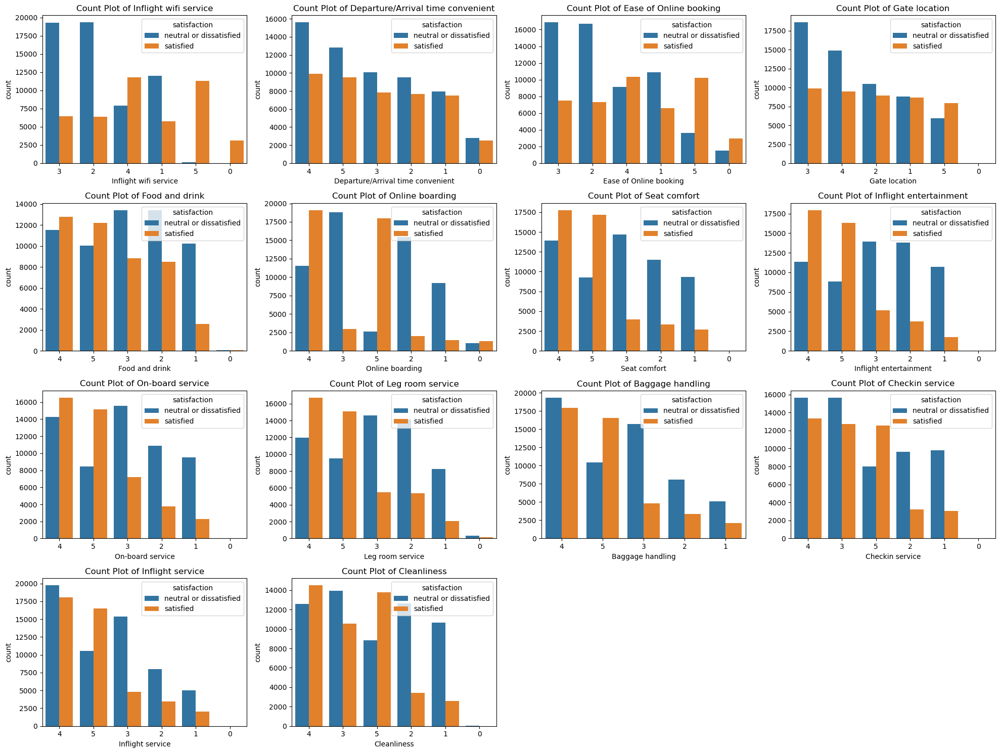

In [24]:
# Satisfaction or dissatisfaction rate for each service 
rat_var = df_train.iloc[:, 6:20]
fig , axs = plt.subplots(nrows=4 , ncols=4 , figsize = (20 , 15))
axs = axs.flatten()
for i , var in enumerate(rat_var):
    sns.countplot(data=df_train , x = var , ax = axs[i] , order= df_train[var].value_counts().index , hue = 'satisfaction')
    axs[i].set_xticklabels(axs[i].get_xticklabels() )
    axs[i].set_title(f"Count Plot of {var}")
    
fig.tight_layout()

fig.delaxes(axs[14])

fig.delaxes(axs[15])

plt.show()

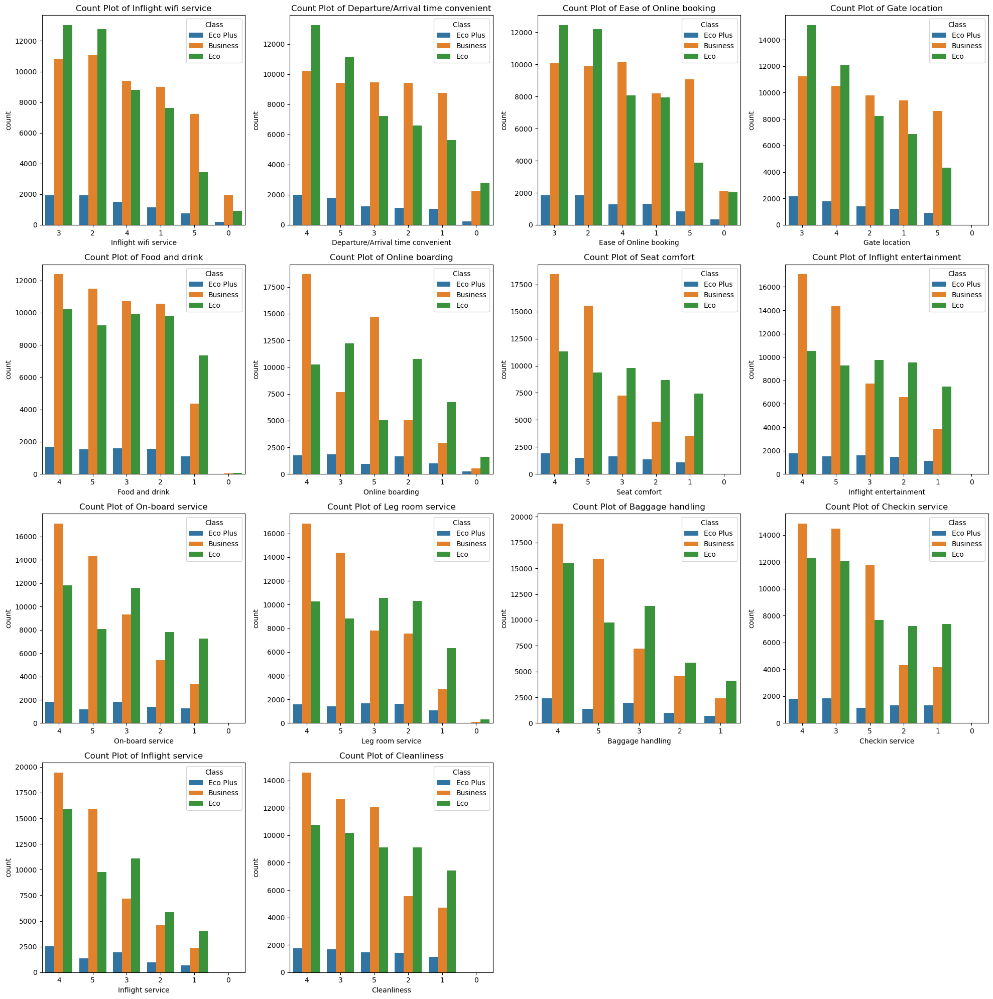

In [25]:
# Class rate for each service 
rat_var = df_train.iloc[:, 6:20]
fig , axs = plt.subplots(nrows=4 , ncols=4 , figsize = (20 , 20))
axs = axs.flatten()
for i , var in enumerate(rat_var):
    sns.countplot(data=df_train , x = var , ax = axs[i] , order= df_train[var].value_counts().index , hue = 'Class')
    axs[i].set_xticklabels(axs[i].get_xticklabels() )
    axs[i].set_title(f"Count Plot of {var}")
    
fig.tight_layout()

fig.delaxes(axs[14])

fig.delaxes(axs[15])

plt.show()

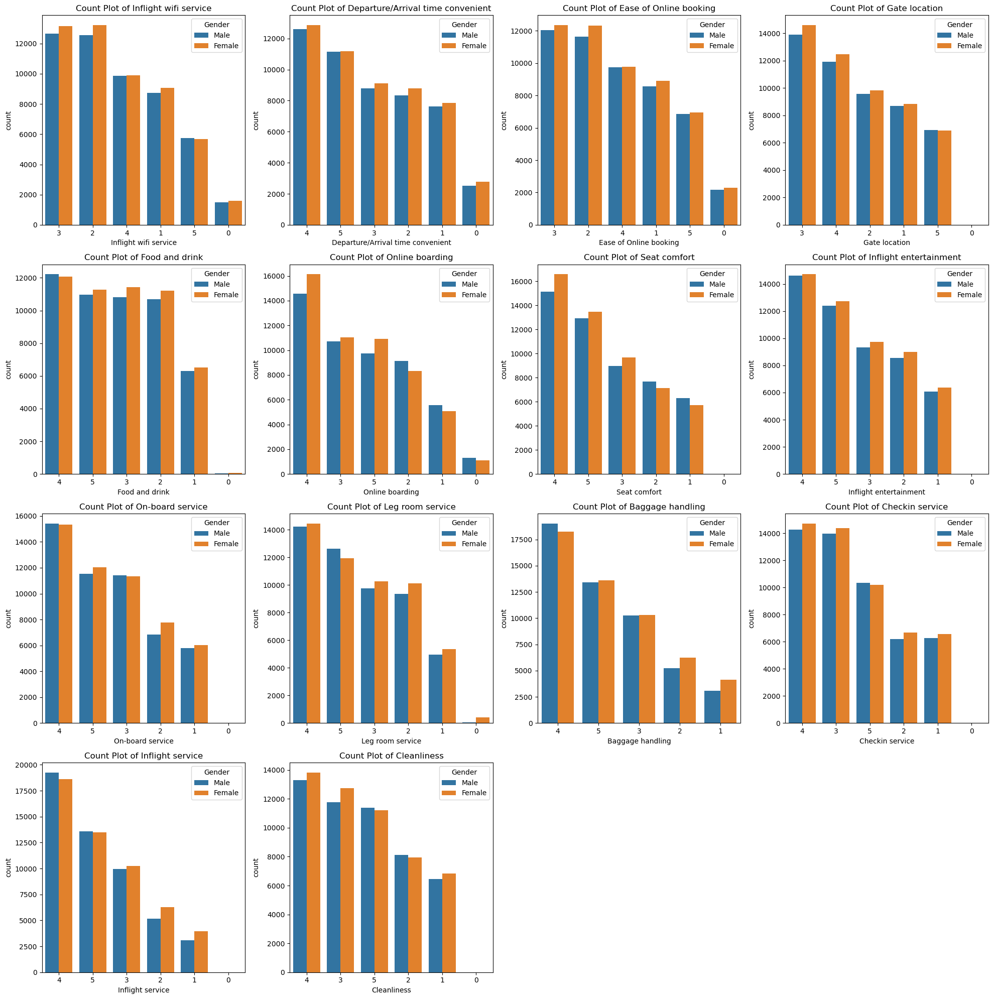

In [26]:
# Gender rate for each service 
rat_var = df_train.iloc[:, 6:20]
fig , axs = plt.subplots(nrows=4 , ncols=4 , figsize = (20 , 20))
axs = axs.flatten()
for i , var in enumerate(rat_var):
    sns.countplot(data=df_train , x = var , ax = axs[i] , order= df_train[var].value_counts().index , hue = 'Gender')
    axs[i].set_xticklabels(axs[i].get_xticklabels() )
    axs[i].set_title(f"Count Plot of {var}")
    
fig.tight_layout()

fig.delaxes(axs[14])

fig.delaxes(axs[15])

plt.show()

<AxesSubplot:>

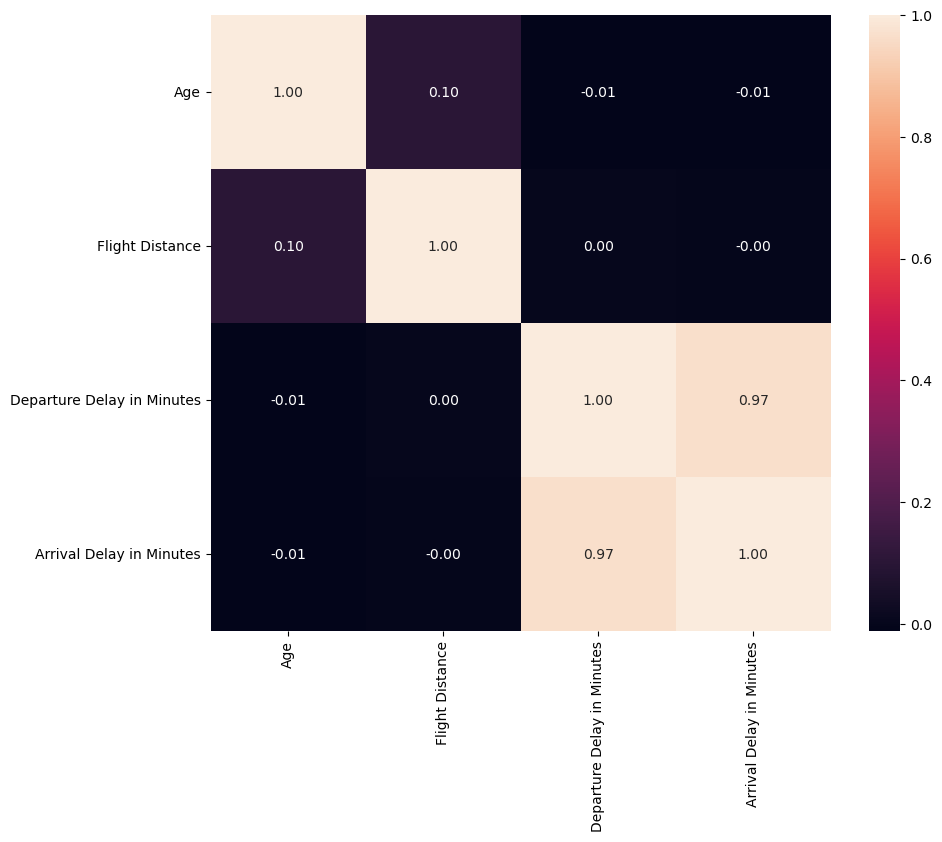

In [27]:
# Create heate map to clarify correlation between numerical features
df_corr = df_train[['Age' , 'Flight Distance' , 'Departure Delay in Minutes' , 'Arrival Delay in Minutes']]
plt.figure(figsize= (10 , 8))
sns.heatmap(df_corr.corr() , fmt = '.2f' , annot = True)

In [28]:
px.box(data_frame = df_train , x = 'Class' , y = 'Age')

In [29]:
px.box(data_frame = df_train , x = 'Gender' , y = 'Age')

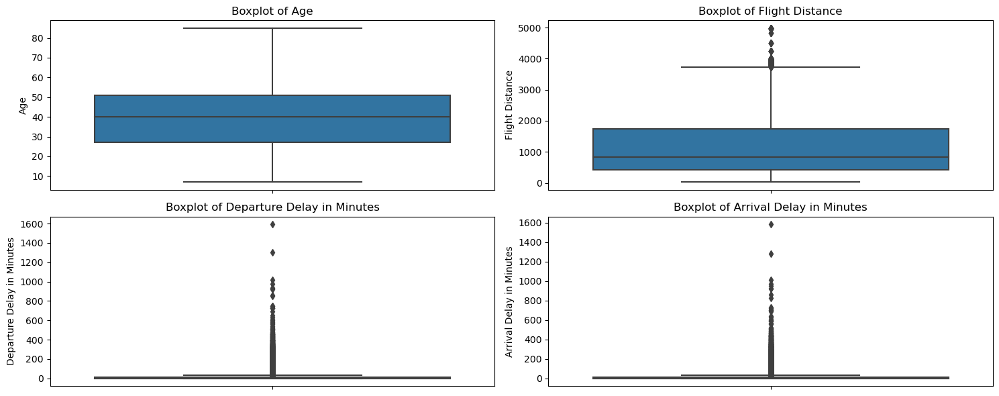

In [30]:
num_var = ['Age' , 'Flight Distance' , 'Departure Delay in Minutes' , 'Arrival Delay in Minutes']
fig , axs = plt.subplots(nrows= 2 , ncols = 2 , figsize = (15 , 6))
axs = axs.flatten()

for i , var in enumerate(num_var):
    sns.boxplot(data=df_train , y = var , ax = axs[i]   )
    
    
    axs[i].set_title(f"Boxplot of {var}")


fig.tight_layout()



plt.show()

In [31]:
# Outlier handling using IQR 
def deal_with_outliers(df , value):
    # intial Q1
    Q1 = df[value].quantile(.25)
    # intial Q3
    Q3 = df[value].quantile(.75)
    # Define IQR
    IQR = Q3 - Q1
    # Define Lower value
    lower = Q1 - 1.5 * IQR
    # Define upper value
    upper = Q3 + 1.5 * IQR
    # replace values
    df[value] = np.where(df[value] > upper , upper ,
            np.where(df[value] < lower , lower , df[value]))
    
    return df[value]

In [32]:
# apply function (deal_with_outliers)
df_train['Departure Delay in Minutes'] = deal_with_outliers(df_train , 'Departure Delay in Minutes')
df_train['Flight Distance'] = deal_with_outliers(df_train , 'Flight Distance')
df_train['Arrival Delay in Minutes'] = deal_with_outliers(df_train , 'Arrival Delay in Minutes')

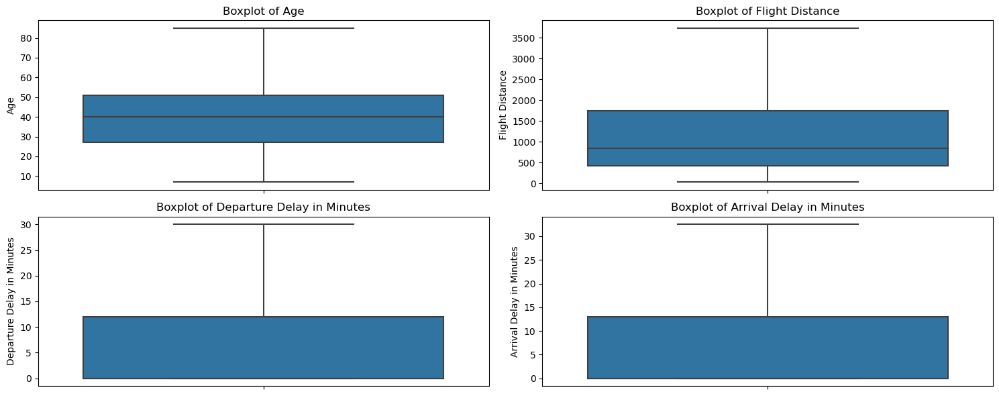

In [33]:
# validate from function
num_var = ['Age' , 'Flight Distance' , 'Departure Delay in Minutes' , 'Arrival Delay in Minutes']
fig , axs = plt.subplots(nrows= 2 , ncols = 2 , figsize = (15 , 6))
axs = axs.flatten()

for i , var in enumerate(num_var):
    sns.boxplot(data=df_train , y = var , ax = axs[i])
    
    
    axs[i].set_title(f"Boxplot of {var}")


fig.tight_layout()



plt.show()

In [34]:
# This  chart visualizes the distribution of satisfaction levels across different gender, class, and customer types
sunb = df_train[['Gender' , 'Class' , 'satisfaction' , 'Age' , 'Customer Type']]
px.sunburst(data_frame = sunb ,
            path= ['Gender' , 'Class' ,'Customer Type', 'satisfaction'] , height=700)

________________________________________________________________

### Create BI Rebort

In [55]:
from powerbiclient import Report , QuickVisualize , get_dataset_config
from powerbiclient.authentication import DeviceCodeLoginAuthentication

In [56]:
device_uth = DeviceCodeLoginAuthentication()

Performing device flow authentication. Please follow the instructions below.
To sign in, use a web browser to open the page https://microsoft.com/devicelogin and enter the code L3AFXHPJ3 to authenticate.

Device flow authentication successfully completed.
You are now logged in .

The result should be passed only to trusted code in your notebook.


In [57]:
report_BI = df_train.select_dtypes(include = 'object')

In [58]:
report = QuickVisualize(get_dataset_config(report_BI) ,auth=device_uth)

In [59]:
report

QuickVisualize()

_________________________________________________________

In [40]:
df_train.iloc[:, 6:20] = df_train.iloc[:, 6:20].astype('int')

In [41]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 103594 entries, 0 to 103903
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             103594 non-null  object 
 1   Customer Type                      103594 non-null  object 
 2   Age                                103594 non-null  int64  
 3   Type of Travel                     103594 non-null  object 
 4   Class                              103594 non-null  object 
 5   Flight Distance                    103594 non-null  float64
 6   Inflight wifi service              103594 non-null  int32  
 7   Departure/Arrival time convenient  103594 non-null  int32  
 8   Ease of Online booking             103594 non-null  int32  
 9   Gate location                      103594 non-null  int32  
 10  Food and drink                     103594 non-null  int32  
 11  Online boarding                    1035

__________________________________________________________

## Spliting

In [42]:
# Split to features and target 
X = df_train.drop(columns = 'satisfaction' , axis = 1)
y = df_train['satisfaction']

<AxesSubplot:xlabel='satisfaction', ylabel='count'>

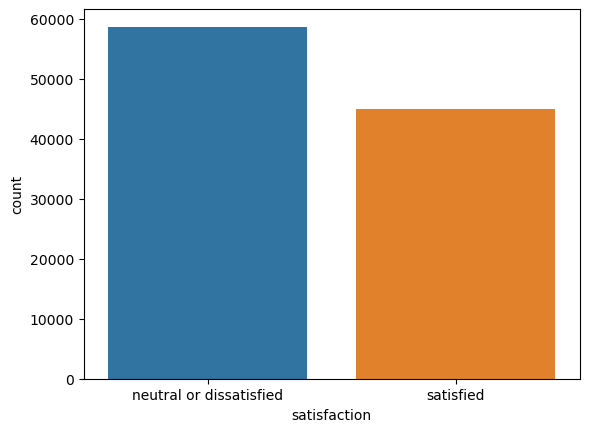

In [43]:
# make sure there is no implanced data
sns.countplot( x = y)

In [44]:
# Make encode for target
y_enco = LabelEncoder()
y_enco = y_enco.fit_transform(y)

In [45]:
# Split to train and test 
X_train , X_test , y_train , y_test =  train_test_split(X , y_enco , test_size = 0.2 , shuffle = True , random_state = 45 , 
                                                        stratify=y )

print('X_train.shap ' , X_train.shape)
print('y_train.shap ' , y_train.shape)
print('X_test.shap ' , X_test.shape)
print('y_test.shap ' , y_test.shape)

X_train.shap  (82875, 22)
y_train.shap  (82875,)
X_test.shap  (20719, 22)
y_test.shap  (20719,)


In [46]:
category_col= ['Gender', 'Customer Type', 'Type of Travel', 'Class']

In [47]:
numerical= ['Departure Delay in Minutes','Arrival Delay in Minutes','Flight Distance','Age']

In [48]:
ready_col= list(set(X_train.columns.to_list()) - set(category_col) - set(numerical))
#['Inflight wifi service','Departure/Arrival time convenient','Ease of Online booking','Gate location','Food and drink',
 #'Online boarding','Seat comfort','Inflight entertainment','On-board service','Leg room service','Baggage handling','Checkin service',
 #'Inflight service','Cleanliness']

In [49]:
## My Pipline

#Numerical --> Impute median , RobustScaler
numerical_pip = Pipeline(steps= [
                ('Selector' , DataFrameSelector(numerical)),
                ('imputer' , SimpleImputer(strategy='median')),
                ('Scaling' , RobustScaler())
])


# Ready_col -- > Impute most_frequent
ready_col = Pipeline(steps= [
            ('Selector' , DataFrameSelector(ready_col)),
            ('imputer' , SimpleImputer(strategy = 'most_frequent'))
])


# Category Labelencoder -- > Impute most_frequent , incodeing 
category_pip = Pipeline(steps=[
                ('Selector', DataFrameSelector(category_col)),
                ('imputer', SimpleImputer(strategy='most_frequent')),
                ('encoding', OrdinalEncoder())
])

all_pip = FeatureUnion(transformer_list=[
    ('numerical_pip', numerical_pip),
    ('ready_col', ready_col),
    ('category_pip', category_pip)
])

X_train_final = all_pip.fit_transform(X_train)
X_test_final = all_pip.transform(X_test)

C:\anaconda3\lib\site-packages\sklearn\impute\_base.py:49: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.



______________________________________________

# Building models 

### Logistic Regression

In [50]:
#Logistic Regression
Log_class = LogisticRegression(C=1 , random_state=45)

#fit
Log_class.fit(X_train_final , y_train)

# predict 
y_pred_Log_train = Log_class.predict(X_train_final)
y_pred_Log_test = Log_class.predict(X_test_final)

#Evaluate
score_Log_train = accuracy_score(y_train , y_pred_Log_train)
score_Log_test = accuracy_score(y_test , y_pred_Log_test)

print(f'this accuracy_score of score_Log_train {score_Log_train *100 :.3f}')
print(f'this accuracy_score of score_Log_test {score_Log_test *100 :.3f}')

this accuracy_score of score_Log_train 87.509
this accuracy_score of score_Log_test 87.707


_______________________________________

## RandomForest

In [51]:
# RandomForest
RF_class =  RandomForestClassifier(n_estimators = 170 , max_depth = 12 ,
                                 random_state = 45 ,)
RF_class.fit(X_train_final , y_train)

# predict 
y_pred_RF_train =  RF_class.predict(X_train_final)
y_pred_RF_test =  RF_class.predict(X_test_final)

#Evaluate
score_RF_train = accuracy_score(y_train , y_pred_RF_train)
score_RF_test = accuracy_score(y_test , y_pred_RF_test)

print(f'this accuracy_score of score_RF_train {score_RF_train *100 :.3f}')
print(f'this accuracy_score of score_RF_test {score_RF_test *100 :.3f}')


this accuracy_score of score_RF_train 96.278
this accuracy_score of score_RF_test 95.347


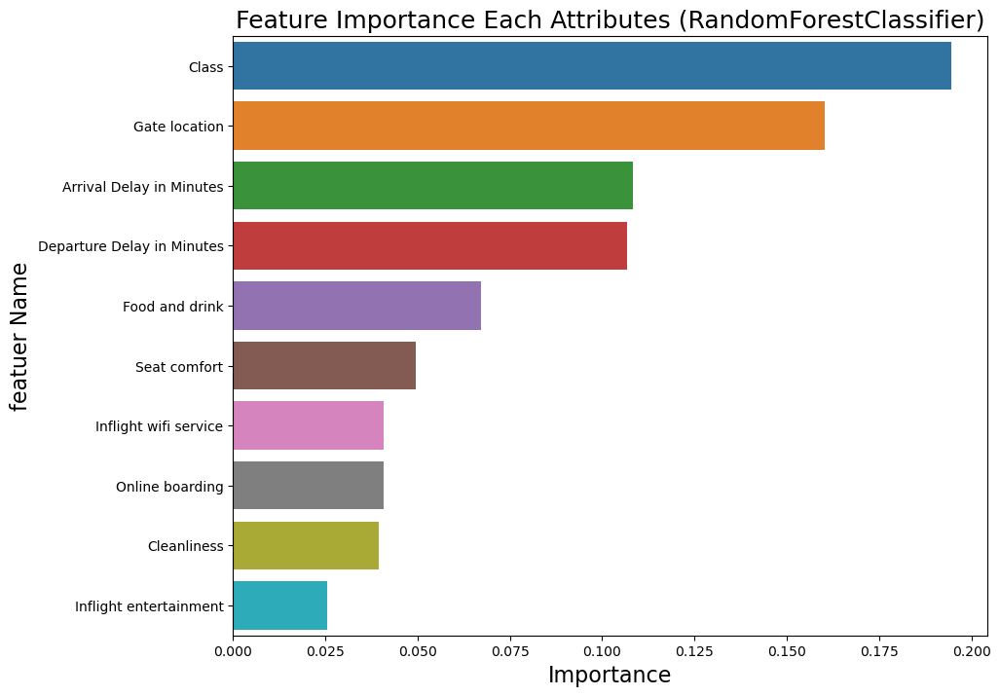

In [52]:
imp_df = pd.DataFrame({
    'featuer Name': X_train.columns,
    'Importance' : RF_class.feature_importances_
})
fi = imp_df.sort_values(by = 'Importance' ,  ascending= False)

fi2 = fi.head(10)
plt.figure(figsize=(10,8))
sns.barplot(data=fi2 , x = 'Importance' , y = 'featuer Name')
plt.title('Feature Importance Each Attributes (RandomForestClassifier)' , fontsize = 18)
plt.xlabel('Importance' , fontsize = 16)
plt.ylabel('featuer Name' , fontsize = 16)
plt.show()

_______________________________________

# KNN

In [53]:
knn_class = KNeighborsClassifier(n_neighbors=3 , p = 2 , metric='minkowski')

knn_class.fit(X_train_final , y_train)

# predict 
y_pred_knn_train = knn_class.predict(X_train_final)
y_pred_knn_test = knn_class.predict(X_test_final)

#Evaluate
score_knn_train = accuracy_score(y_train , y_pred_knn_train)
score_knn_test = accuracy_score(y_test , y_pred_knn_test)

print(f'this accuracy_score of score_knn_train {score_knn_train *100 :.3f}')
print(f'this accuracy_score of score_knn_test {score_knn_test *100 :.3f}')


C:\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.



this accuracy_score of score_knn_train 95.937
this accuracy_score of score_knn_test 92.529


__________________________________________

# XGBClassifier

In [54]:
XG_class = XGBClassifier(objective='binary:logistic' , subsample = 0.8 , colsample_bytree = 0.7)

XG_class.fit(X_train_final , y_train)

# predict 
y_pred_XG_train = XG_class.predict(X_train_final)
y_pred_XG_test = XG_class.predict(X_test_final)

#Evaluate
score_XG_train = accuracy_score(y_train , y_pred_XG_train)
score_XG_test = accuracy_score(y_test , y_pred_XG_test)

print(f'this accuracy_score of score_XG_train {score_XG_train *100 :.3f}')
print(f'this accuracy_score of score_XG_test {score_XG_test *100 :.3f}')


this accuracy_score of score_XG_train 97.721
this accuracy_score of score_XG_test 96.370
